<a href="https://colab.research.google.com/github/AntMigGF/plantcv/blob/master/Segmentacion_Bordes.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import numpy as np
import glob
import matplotlib.pyplot as plt
#import ipympl
import imageio.v3 as iio
import skimage.color
import skimage.filters
import pandas as pd
#%matplotlib widget


def measure_plant_mass(filename, sigma=1.0):

    # read the original image, converting to grayscale on the fly
    image = iio.imread(uri=filename)

    height, width = image.shape[:2]
    # Definir el tamaño del recorte central
    crop_width = int(width * 0.8)  # Anchura del recorte
    crop_height = int(height * 0.8)  # Altura del recorte

    # Calcular las coordenadas de inicio y fin del recorte
    start_x = int((width - crop_width) / 2)
    end_x = start_x + crop_width
    start_y = int((height - crop_height) / 2)
    end_y = start_y + crop_height

    # Recortar la imagen
    cropped_image = image[start_y:end_y, start_x:end_x]


    # before thresholding
    raw_image = skimage.filters.gaussian(cropped_image, sigma=sigma)

    # perform automatic thresholding to produce a binary image
    t = skimage.filters.threshold_otsu(raw_image)
    binary_mask = raw_image < t

    selection = raw_image.copy()
    selection[~binary_mask] = 0
    plant_s = selection[selection != 0]
    df_describe = pd.DataFrame(plant_s)
    df_describe = df_describe.describe()
    list_des = df_describe[0].tolist()

    # determine plant mass ratio
    plantPixels = np.count_nonzero(binary_mask)
    w = binary_mask.shape[1]
    h = binary_mask.shape[0]
    density = plantPixels / (w * h)

    return density, list_des, selection

# AHORA CON IMÁGENES PROBLEMÁTICAS: 2023

Found automatic threshold t = 0.05027611553668976. C:/Users/AM_GF/Escritorio/20230330/tif\FLIR2527.tif
Found automatic threshold t = 0.04287282004952431. C:/Users/AM_GF/Escritorio/20230330/tif\FLIR2528.tif
Found automatic threshold t = 0.04282699152827263. C:/Users/AM_GF/Escritorio/20230330/tif\FLIR2529.tif
Found automatic threshold t = 0.04374644160270691. C:/Users/AM_GF/Escritorio/20230330/tif\FLIR2530.tif
Found automatic threshold t = 0.046403028070926666. C:/Users/AM_GF/Escritorio/20230330/tif\FLIR2531.tif
Found automatic threshold t = 0.041064754128456116. C:/Users/AM_GF/Escritorio/20230330/tif\FLIR2532.tif
Found automatic threshold t = 0.045720722526311874. C:/Users/AM_GF/Escritorio/20230330/tif\FLIR2533.tif
Found automatic threshold t = 0.04151023551821709. C:/Users/AM_GF/Escritorio/20230330/tif\FLIR2534.tif
Found automatic threshold t = 0.047767188400030136. C:/Users/AM_GF/Escritorio/20230330/tif\FLIR2535.tif
Found automatic threshold t = 0.05046552047133446. C:/Users/AM_GF/Esc

C:\Users\AM_GF\AppData\Local\Temp\ipykernel_2772\3625708909.py:13: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Found automatic threshold t = 0.04476424306631088. C:/Users/AM_GF/Escritorio/20230330/tif\FLIR2551.tif
Found automatic threshold t = 0.04570023715496063. C:/Users/AM_GF/Escritorio/20230330/tif\FLIR2552.tif
Found automatic threshold t = 0.04464368894696236. C:/Users/AM_GF/Escritorio/20230330/tif\FLIR2553.tif
Found automatic threshold t = 0.043978143483400345. C:/Users/AM_GF/Escritorio/20230330/tif\FLIR2554.tif
Found automatic threshold t = 0.05570123344659805. C:/Users/AM_GF/Escritorio/20230330/tif\FLIR2555.tif
Found automatic threshold t = 0.05409085005521774. C:/Users/AM_GF/Escritorio/20230330/tif\FLIR2556.tif
Found automatic threshold t = 0.052808135747909546. C:/Users/AM_GF/Escritorio/20230330/tif\FLIR2557.tif
Found automatic threshold t = 0.04576344043016434. C:/Users/AM_GF/Escritorio/20230330/tif\FLIR2558.tif
Found automatic threshold t = 0.04346046969294548. C:/Users/AM_GF/Escritorio/20230330/tif\FLIR2559.tif
Found automatic threshold t = 0.04677657410502434. C:/Users/AM_GF/Escri

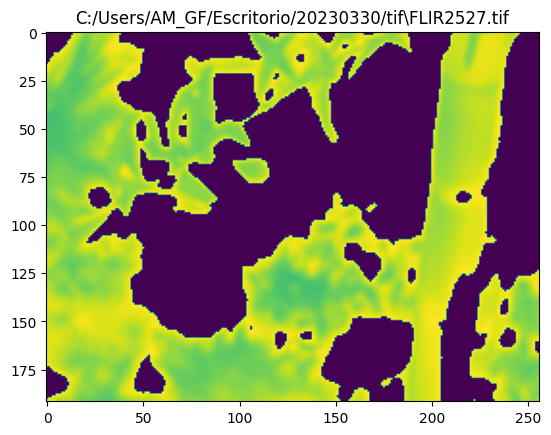

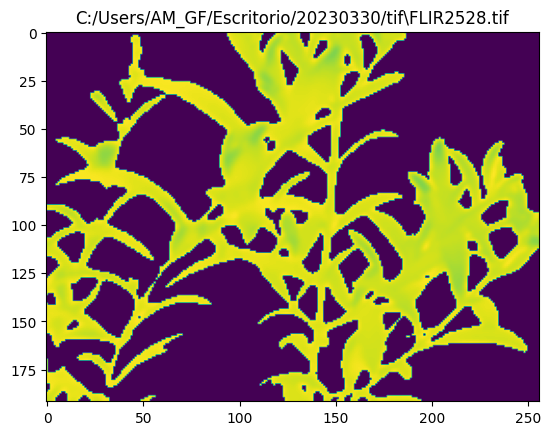

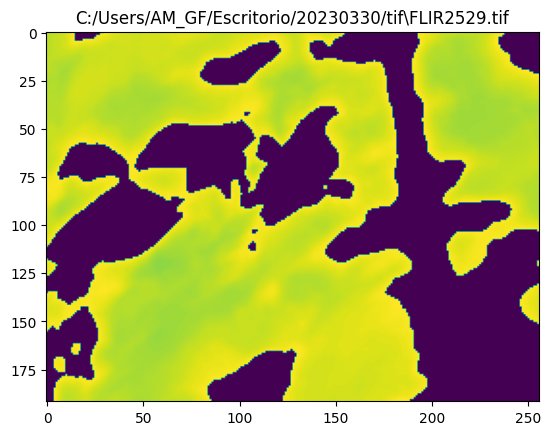

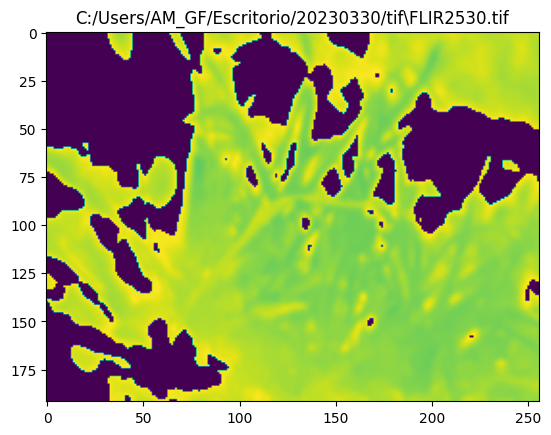

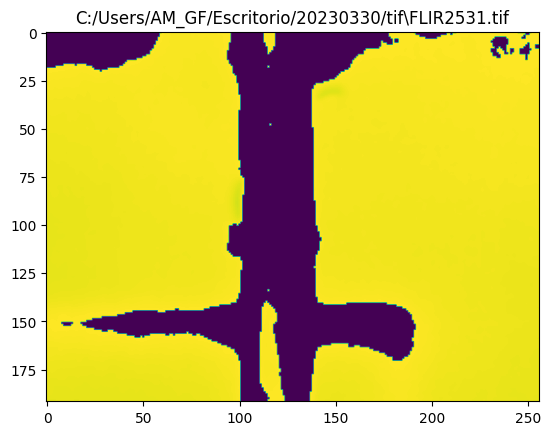

...

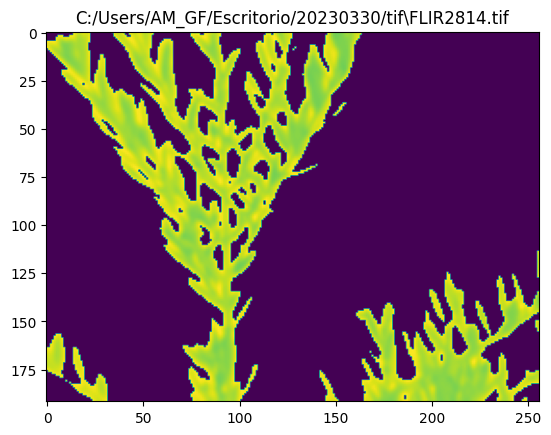

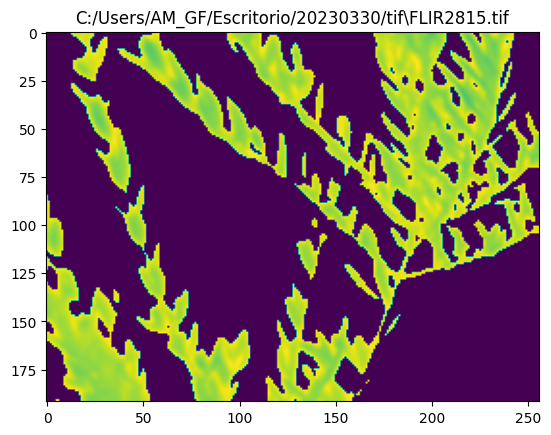

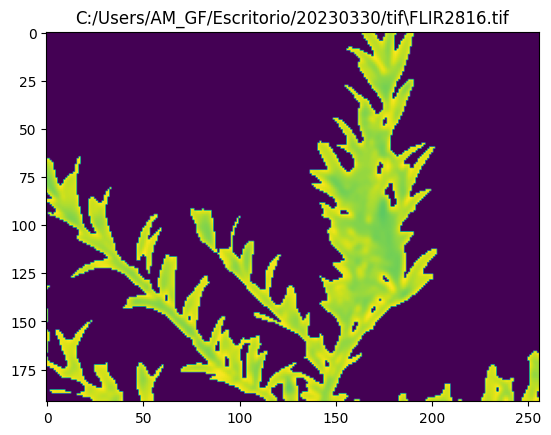

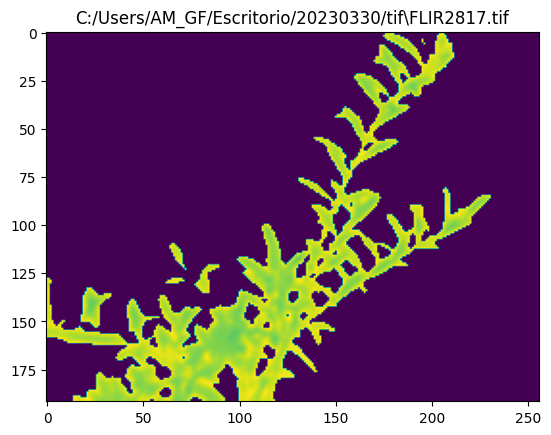

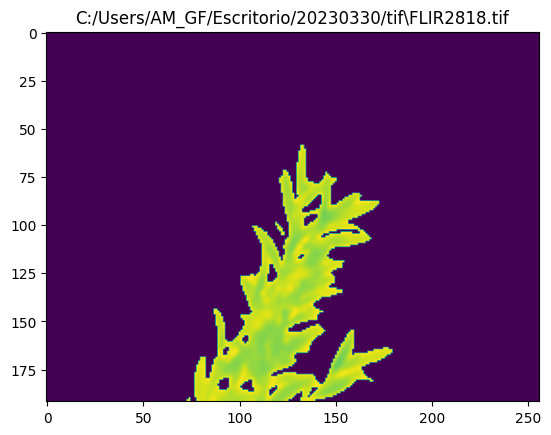

In [ ]:
lista_e = []
selections=[]
all_files = glob.glob("C:/Users/AM_GF/Escritorio/20230330/tif/*.tif")
for filename in all_files:
    density, des_list, selection_raw = measure_plant_mass(filename=filename, sigma=1.0)
    # output in format suitable for .csv
    #print(filename, "plant_desnity_bypixel", density, "plat_thermal_describestats = ", des_list, sep=",")
    lista = [filename,density,des_list]
    lista_e.append(lista)
    #selections.append(selection_raw)
    t = skimage.filters.threshold_otsu(selection_raw)
    print("Found automatic threshold t = {}.".format(t), filename)
    fig, ax = plt.subplots()
    ax.set_title(filename)
    plt.imshow(selection_raw)



data = pd.DataFrame(lista_e)
data[['count', 'mean', 'std', 'min', '25%', '50%', '75%', 'max']] = pd.DataFrame(data[2].tolist(), index= data.index)
data.drop(columns=2, inplace=True)
data.rename(columns={0:'name',1:'density'}, inplace=True)

In [ ]:
data

,name,density,count,mean,std,min,25%,50%,75%,max
0,C:/Users/AM_GF/Escritorio/20230330/tif\FLIR252...,0.560506,27550.0,22.654188,1.808083,18.052412,21.280616,22.745556,24.183455,25.741371
1,C:/Users/AM_GF/Escritorio/20230330/tif\FLIR252...,0.377360,18548.0,20.812284,0.720713,17.675379,20.384718,20.884936,21.362271,21.950884
2,C:/Users/AM_GF/Escritorio/20230330/tif\FLIR252...,0.636698,31295.0,20.355785,0.856395,18.148634,19.666565,20.387484,21.007410,21.927420
3,C:/Users/AM_GF/Escritorio/20230330/tif\FLIR253...,0.697042,34261.0,19.645088,1.281875,16.908762,18.536827,19.567240,20.581839,22.398178
4,C:/Users/AM_GF/Escritorio/20230330/tif\FLIR253...,0.772909,37990.0,23.342272,0.208652,22.147108,23.200352,23.343608,23.493680,23.758350
...,...,...,...,...,...,...,...,...,...,...
287,C:/Users/AM_GF/Escritorio/20230330/tif\FLIR281...,0.264160,12984.0,24.642864,1.436959,21.153208,23.500564,24.692438,25.859169,27.016912
288,C:/Users/AM_GF/Escritorio/20230330/tif\FLIR281...,0.335266,16479.0,23.708710,1.483394,19.084454,22.524459,23.742344,24.983740,26.185810
289,C:/Users/AM_GF/Escritorio/20230330/tif\FLIR281...,0.217428,10687.0,25.676155,1.570696,21.229727,24.446277,25.735199,27.021810,28.275381
290,C:/Users/AM_GF/Escritorio/20230330/tif\FLIR281...,0.176432,8672.0,23.964172,1.496760,19.804310,22.798057,24.076906,25.226013,26.398071


array([[<AxesSubplot:title={'center':'mean'}>]], dtype=object)

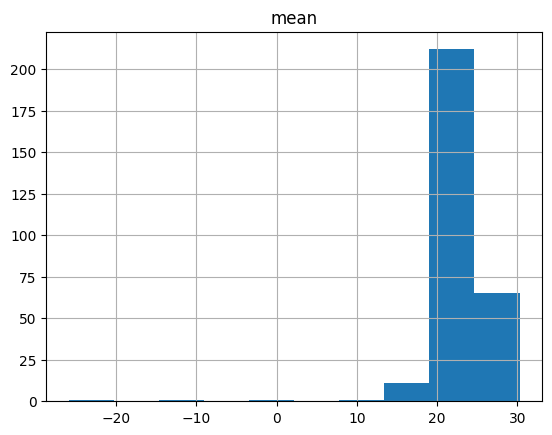

In [ ]:
data.hist('mean')